In [63]:
import cv2
from matplotlib import pyplot as plt
import numpy as np
import os
import pandas as pd
import random
from skimage import io
from shutil import copyfile
import sys
import time

import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import wget
import tqdm



In [64]:
url = 'https://storage.googleapis.com/openimages/2018_04/train/train-annotations-bbox.csv'
filename = wget.download(url)

In [65]:
url = 'https://storage.googleapis.com/openimages/2018_04/train/train-images-boxable-with-rotation.csv'
filename = wget.download(url)
url = 'https://storage.googleapis.com/openimages/v5/class-descriptions-boxable.csv'
filename = wget.download(url)

In [66]:
images_boxable_file = 'train-images-boxable-with-rotation.csv'
annotations_bbox_file = 'train-annotations-bbox.csv'
class_descriptions_file = 'class-descriptions-boxable.csv'

In [67]:
images_boxable = pd.read_csv(images_boxable_file)
images_boxable.head()

,ImageID,Subset,OriginalURL,OriginalLandingURL,License,AuthorProfileURL,Author,Title,OriginalSize,OriginalMD5,Thumbnail300KURL,Rotation
0,4fa8054781a4c382,train,https://farm3.staticflickr.com/5310/5898076654...,https://www.flickr.com/photos/michael-beat/589...,https://creativecommons.org/licenses/by/2.0/,https://www.flickr.com/people/michael-beat/,Michael Beat,...die FNF-Kerze,4405052,KFukvivpCM5QXl5SqKe41g==,https://c1.staticflickr.com/6/5310/5898076654_...,0.0
1,b37f763ae67d0888,train,https://c1.staticflickr.com/1/67/197493648_628...,https://www.flickr.com/photos/drstarbuck/19749...,https://creativecommons.org/licenses/by/2.0/,https://www.flickr.com/people/drstarbuck/,Karen,Three boys on a hill,494555,9IzEn38GRNsVpATuv7gzEA==,https://c3.staticflickr.com/1/67/197493648_628...,0.0
2,7e8584b0f487cb9e,train,https://c7.staticflickr.com/8/7056/7143870979_...,https://www.flickr.com/photos/circasassy/71438...,https://creativecommons.org/licenses/by/2.0/,https://www.flickr.com/people/circasassy/,CircaSassy,A Christmas carol and The cricket on the heart...,2371584,3hQwu0iSzY1VIoXiwp0/Mg==,https://c7.staticflickr.com/8/7056/7143870979_...,0.0
3,86638230febe21c4,train,https://farm5.staticflickr.com/5128/5301868579...,https://www.flickr.com/photos/ajcreencia/53018...,https://creativecommons.org/licenses/by/2.0/,https://www.flickr.com/people/ajcreencia/,Alex,Abbey and Kenny,949267,onB+rCZnGQg5PRX7xOs18Q==,https://c4.staticflickr.com/6/5128/5301868579_...,NaN
4,249086e72671397d,train,https://c6.staticflickr.com/4/3930/15342460029...,https://www.flickr.com/photos/codnewsroom/1534...,https://creativecommons.org/licenses/by/2.0/,https://www.flickr.com/people/codnewsroom/,COD Newsroom,Suburban Law Enforcement Academy 20th Annivers...,6541758,MjpaAVbMAWbCusSaxI1D7w==,https://c1.staticflickr.com/4/3930/15342460029...,0.0


In [68]:
annotations_bbox = pd.read_csv(annotations_bbox_file)
annotations_bbox.head()

,ImageID,Source,LabelName,Confidence,XMin,XMax,YMin,YMax,IsOccluded,IsTruncated,IsGroupOf,IsDepiction,IsInside
0,000002b66c9c498e,xclick,/m/01g317,1,0.012500,0.195312,0.148438,0.587500,0,1,0,0,0
1,000002b66c9c498e,xclick,/m/01g317,1,0.025000,0.276563,0.714063,0.948438,0,1,0,0,0
2,000002b66c9c498e,xclick,/m/01g317,1,0.151562,0.310937,0.198437,0.590625,1,0,0,0,0
3,000002b66c9c498e,xclick,/m/01g317,1,0.256250,0.429688,0.651563,0.925000,1,0,0,0,0
4,000002b66c9c498e,xclick,/m/01g317,1,0.257812,0.346875,0.235938,0.385938,1,0,0,0,0


In [69]:
class_descriptions = pd.read_csv(class_descriptions_file, header=None)
class_descriptions.head()

,0,1
0,/m/011k07,Tortoise
1,/m/011q46kg,Container
2,/m/012074,Magpie
3,/m/0120dh,Sea turtle
4,/m/01226z,Football


In [70]:
def plot_bbox(img_id):
  img_url = images_boxable.loc[images_boxable["ImageID"]==img_id]['OriginalURL'].values[0]
  img = io.imread(img_url)
  height, width, channel = img.shape
  print(f"Image: {img.shape}")
  bboxs = annotations_bbox[annotations_bbox['ImageID']==img_id]
  for index, row in bboxs.iterrows():
      xmin = row['XMin']
      xmax = row['XMax']
      ymin = row['YMin']
      ymax = row['YMax']
      xmin = int(xmin*width)
      xmax = int(xmax*width)
      ymin = int(ymin*height)
      ymax = int(ymax*height)
      label_name = row['LabelName']
      class_series = class_descriptions[class_descriptions[0]==label_name]
      class_name = class_series[1].values[0]
      print(f"Coordinates: {xmin,ymin}, {xmax,ymax}")
      cv2.rectangle(img, (xmin,ymin), (xmax,ymax), (255,0,0), 5)
      font = cv2.FONT_HERSHEY_SIMPLEX
      cv2.putText(img, class_name, (xmin,ymin-10), font, 3, (0,255,0), 5)
  plt.figure(figsize=(15,10))
  plt.title('Image with Bounding Box')
  plt.imshow(img)
  plt.axis("off")
  plt.show()

Image: (1944, 2592, 3)
Coordinates: (573, 285), (2159, 1624)


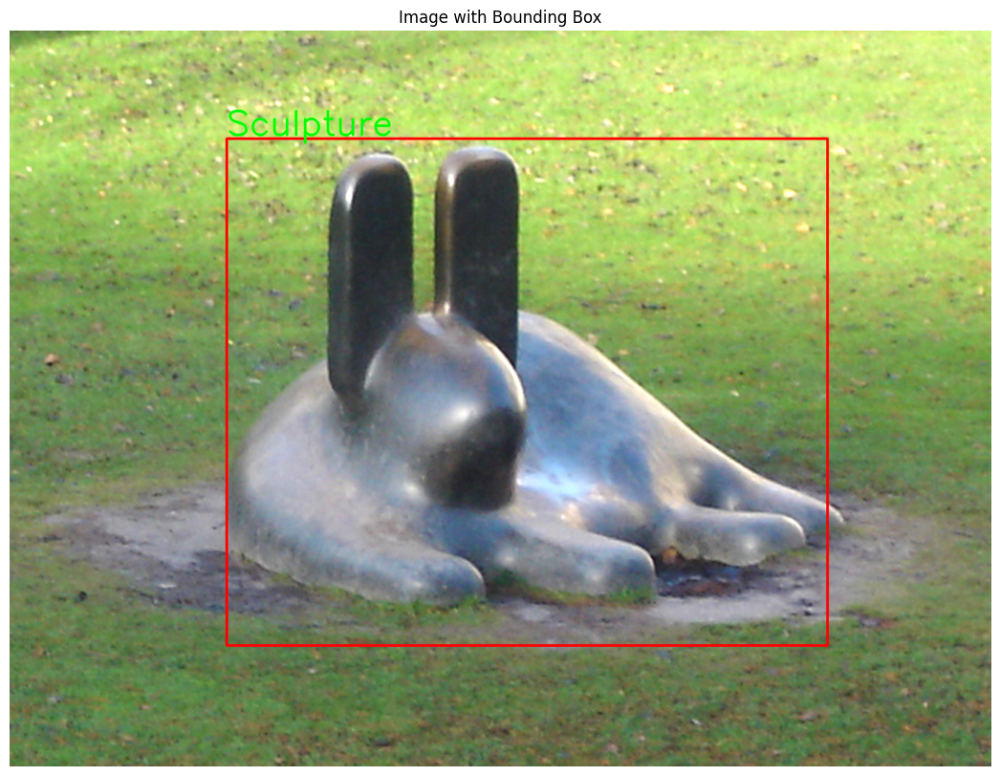

Image: (2500, 2114, 3)
Coordinates: (1967, 1092), (2099, 1193)


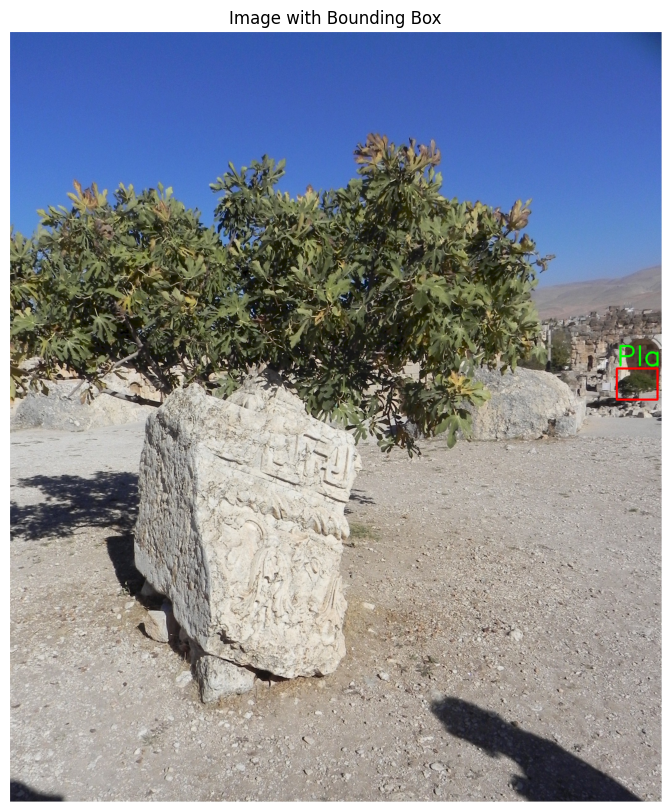

Image: (1536, 2048, 3)
Coordinates: (252, 0), (2046, 1534)


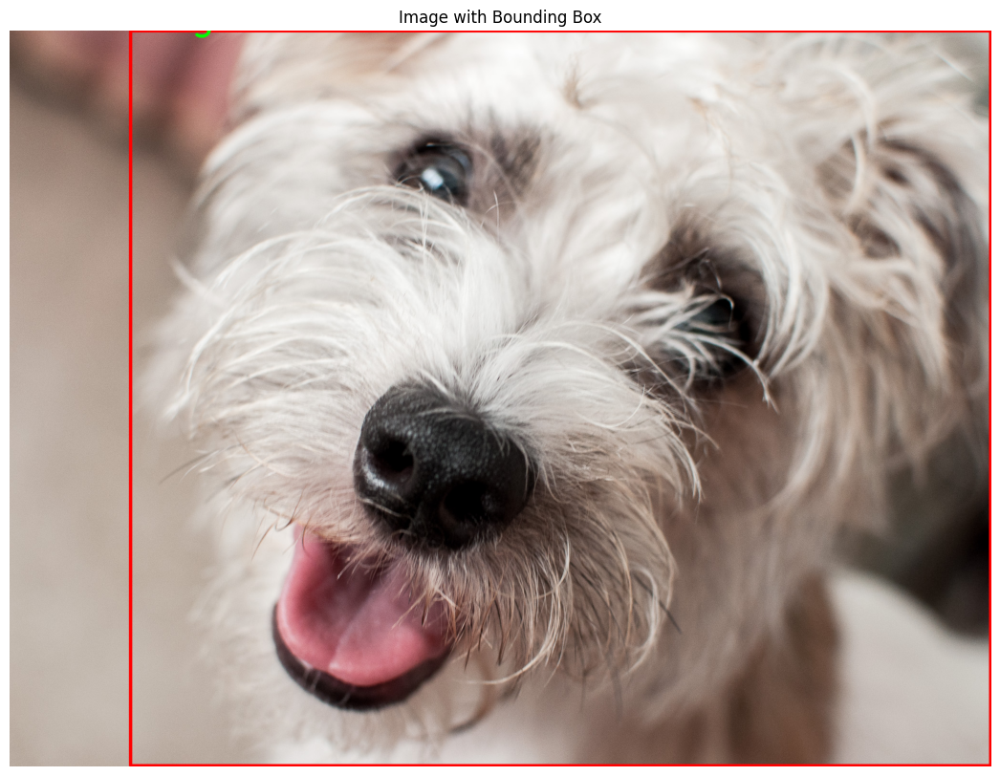

Image: (1518, 2400, 3)
Coordinates: (820, 991), (1350, 1360)


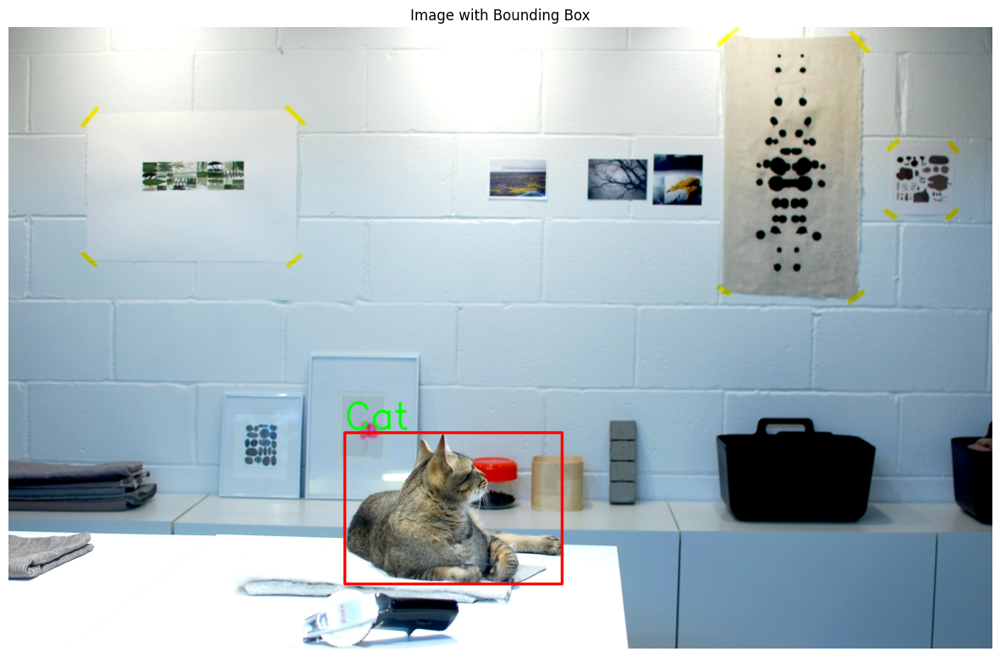

Image: (2298, 3064, 3)
Coordinates: (109, 241), (3064, 2298)


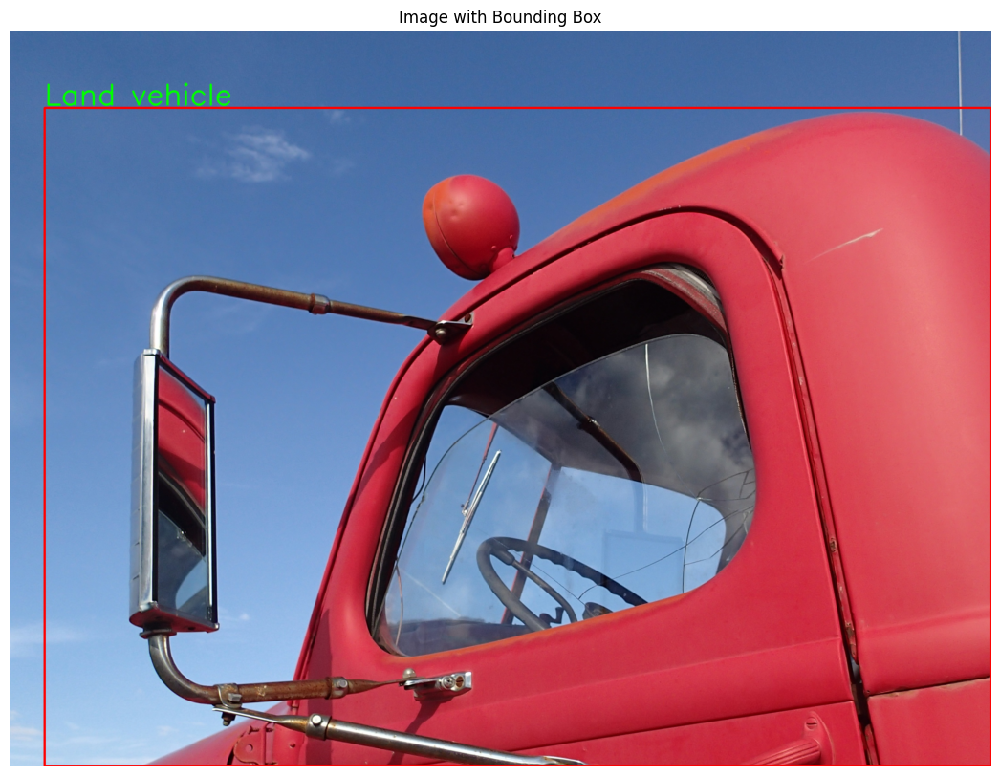

In [71]:
least_objects_img_ids = annotations_bbox["ImageID"].value_counts().tail(50).index.values

for img_id in random.sample(list(least_objects_img_ids), 1):
  plot_bbox(img_id)

In [72]:
class_descriptions[1].count()

601

In [73]:
bed_pd = class_descriptions[class_descriptions[1]=='Bed']
chair_pd = class_descriptions[class_descriptions[1]=='Chair']
table_pd = class_descriptions[class_descriptions[1]=='Table']

In [74]:
label_name_bed = bed_pd[0].values[0]
label_name_chair = chair_pd[0].values[0]
label_name_table = table_pd[0].values[0]

label_name_bed

'/m/03ssj5'

In [75]:
bed_bbox = annotations_bbox[annotations_bbox['LabelName']==label_name_bed]
chair_bbox = annotations_bbox[annotations_bbox['LabelName']==label_name_chair]
table_bbox = annotations_bbox[annotations_bbox['LabelName']==label_name_table]

bed_bbox

,ImageID,Source,LabelName,Confidence,XMin,XMax,YMin,YMax,IsOccluded,IsTruncated,IsGroupOf,IsDepiction,IsInside
5953,00041cc3701f7805,xclick,/m/03ssj5,1,0.135112,0.366609,0.420573,0.625000,1,0,0,0,0
5954,00041cc3701f7805,xclick,/m/03ssj5,1,0.179862,0.405336,0.436198,0.856771,0,0,0,0,0
9974,00074503ceae5131,xclick,/m/03ssj5,1,0.000000,0.999375,0.000000,0.999062,1,1,0,0,0
13671,000a54f1bdb96839,xclick,/m/03ssj5,1,0.000000,0.999167,0.028125,0.999375,0,1,0,0,0
17469,000da932ca7e68e4,xclick,/m/03ssj5,1,0.000000,0.753125,0.328330,0.993433,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
14585203,ff7f55b7f6794f63,xclick,/m/03ssj5,1,0.000000,0.999375,0.000000,0.997500,1,1,0,0,0
14595452,ffb716498f082103,xclick,/m/03ssj5,1,0.180000,0.998750,0.309568,0.998124,0,0,0,0,0
14600295,ffce182988b6b746,xclick,/m/03ssj5,1,0.000000,0.305625,0.707317,0.999062,0,1,0,0,0
14602507,ffd718211ba34626,activemil,/m/03ssj5,1,0.006250,0.207500,0.373333,0.805000,1,1,0,0,0


In [102]:
print('There are %d beds in the dataset' %(len(bed_bbox)))
print('There are %d chairs in the dataset' %(len(chair_bbox)))
print('There are %d tables in the dataset' %(len(table_bbox)))

There are 3563 beds in the dataset
There are 132483 chairs in the dataset
There are 85691 tables in the dataset


In [106]:
bed_img_id = bed_bbox['ImageID']
chair_img_id = chair_bbox['ImageID']
table_img_id = table_bbox['ImageID']


In [121]:

subbed_img_id = random.sample(list(bed_img_id), 3000)
subchair_img_id = random.sample(list(chair_img_id), 3000)
subtable_img_id = random.sample(list(table_img_id), 3000)

In [122]:
subbed_pd = images_boxable.loc[images_boxable['ImageID'].isin(subbed_img_id)]
subchair_pd = images_boxable.loc[images_boxable['ImageID'].isin(subchair_img_id)]
subtable_pd = images_boxable.loc[images_boxable['ImageID'].isin(subtable_img_id)]

In [123]:
print("Beds:",subbed_pd.shape, "Chair:", subchair_pd.shape, "Tables:", subtable_pd.shape)

Beds: (2526, 12) Chair: (2619, 12) Tables: (2882, 12)


In [124]:
subbed_pd.head()

,ImageID,Subset,OriginalURL,OriginalLandingURL,License,AuthorProfileURL,Author,Title,OriginalSize,OriginalMD5,Thumbnail300KURL,Rotation
30,32ae9bc90b0df9fb,train,https://c4.staticflickr.com/7/6221/6271161652_...,https://www.flickr.com/photos/erin_costa/62711...,https://creativecommons.org/licenses/by/2.0/,https://www.flickr.com/people/erin_costa/,Erin Costa,Ireland Trip - Bunratty Castle Bed,2394637,LMpMQtgyrVqIh0g6q4fRMw==,https://c7.staticflickr.com/7/6221/6271161652_...,0.0
337,a31e5cab27e4db52,train,https://farm3.staticflickr.com/7064/6945245769...,https://www.flickr.com/photos/chuybenitez/6945...,https://creativecommons.org/licenses/by/2.0/,https://www.flickr.com/people/chuybenitez/,Chuy Benitez,Candace Moore- &quot;Family Portrait VII&quot;,252273,Lr+8QnFWKoTVaBBhc+f78Q==,https://c4.staticflickr.com/8/7064/6945245769_...,0.0
1102,448a341c72fb7c6c,train,https://c5.staticflickr.com/4/3730/19576749362...,https://www.flickr.com/photos/ninian_reid/1957...,https://creativecommons.org/licenses/by/2.0/,https://www.flickr.com/people/ninian_reid/,Ninian Reid,"Twa wrinklies, ain wi' nae teeth",70845,6eYKKndtiodppeyjCKbKHQ==,NaN,NaN
2103,3c22ed97f249de8a,train,https://c3.staticflickr.com/3/2685/4434781270_...,https://www.flickr.com/photos/mojavedesert/443...,https://creativecommons.org/licenses/by/2.0/,https://www.flickr.com/people/mojavedesert/,Mojave Desert,Chaise,886661,0gut4lHgsrta02Z1+t65XA==,https://c4.staticflickr.com/3/2685/4434781270_...,0.0
2341,9626af001bf109cb,train,https://c4.staticflickr.com/7/6150/6007712146_...,https://www.flickr.com/photos/eager/6007712146,https://creativecommons.org/licenses/by/2.0/,https://www.flickr.com/people/eager/,準建築人手札網站 Forgemind ArchiMedia,Nini Andrade Silva - Aquapura Doudo Vallery 25...,147647,7KeyOlwGFvdUai9N/SoClA==,https://c7.staticflickr.com/7/6150/6007712146_...,0.0


In [125]:
subbed_dict = subbed_pd[["ImageID", "OriginalURL"]].set_index('ImageID')["OriginalURL"].to_dict()
subchair_dict = subchair_pd[["ImageID", "OriginalURL"]].set_index('ImageID')["OriginalURL"].to_dict()
subtable_dict = subtable_pd[["ImageID", "OriginalURL"]].set_index('ImageID')["OriginalURL"].to_dict()

subbed_dict

{'32ae9bc90b0df9fb': 'https://c4.staticflickr.com/7/6221/6271161652_b21a5c487e_o.jpg',
 'a31e5cab27e4db52': 'https://farm3.staticflickr.com/7064/6945245769_7f7e9120c2_o.jpg',
 '448a341c72fb7c6c': 'https://c5.staticflickr.com/4/3730/19576749362_748debbfd7_o.jpg',
 '3c22ed97f249de8a': 'https://c3.staticflickr.com/3/2685/4434781270_6f735d4c20_o.jpg',
 '9626af001bf109cb': 'https://c4.staticflickr.com/7/6150/6007712146_60941b6e24_o.jpg',
 '4d0ec26ce32c7d18': 'https://c1.staticflickr.com/8/7577/15668026623_3d2c63cee7_o.jpg',
 '8c971c34573fa82b': 'https://c4.staticflickr.com/6/5616/15340017988_baecf3c222_o.jpg',
 '2b05dee1bb0edf2c': 'https://c5.staticflickr.com/1/165/400829753_44168f1a4a_o.jpg',
 'dd5b456818c94343': 'https://farm4.staticflickr.com/2001/2187889220_2431fa0cbb_o.jpg',
 '0d3306d356d79fd5': 'https://farm6.staticflickr.com/5615/15414009249_aecf0f5b67_o.jpg',
 '2197589e635fc6d8': 'https://c1.staticflickr.com/1/128/373254695_7bf3ed0121_o.jpg',
 '2676430c9fa591d7': 'https://farm8.stat

In [126]:
mappings = [subbed_dict, subchair_dict, subtable_dict]


In [127]:
len(mappings[0])

2526

In [128]:
classes = ['Bed', 'Chair', 'Table']

In [129]:
for idx, obj_type in enumerate(classes):
  n_issues = 0
  # create the directory
  if not os.path.exists(obj_type):
    os.mkdir(obj_type)
  for img_id, url in mappings[idx].items():
    try:
      img = io.imread(url)
      saved_path = os.path.join(obj_type, img_id+".jpg")
      io.imsave(saved_path, img)
    except Exception as e:
      n_issues += 1
  print(f"Images Issues: {n_issues}")

Images Issues: 362
Images Issues: 275


d:\Development\Faster RCNN\venv\lib\site-packages\PIL\TiffImagePlugin.py:643: UserWarning: Metadata Warning, tag 33723 had too many entries: 4, expected 1
  warnings.warn(


Images Issues: 301


In [130]:
train_path = 'train'
test_path = 'test'

In [131]:
for i in range(len(classes)):
    all_imgs = os.listdir(classes[i])
    all_imgs = [f for f in all_imgs if not f.startswith('.')]
    random.shuffle(all_imgs)
    
    limit = int(n*0.8) # 80% data for training and 20% for testing

    train_imgs = all_imgs[:limit]
    test_imgs = all_imgs[limit:]
    
    
    for j in range(len(train_imgs)):
        original_path = os.path.join(classes[i], train_imgs[j])
        new_path = os.path.join(train_path, train_imgs[j])
        copyfile(original_path, new_path)
    

    for j in range(len(test_imgs)):
        original_path = os.path.join(classes[i], test_imgs[j])
        new_path = os.path.join(test_path, test_imgs[j])
        copyfile(original_path, new_path)

In [132]:
train_img_count = os.listdir('./train')
print("Number of images in train found: ", len(train_img_count))

Number of images in train found:  24


In [133]:
test_img_count = os.listdir('./test')
print("Number of images in train found: ", len(test_img_count))

Number of images in train found:  6911


In [134]:
label_names = [label_name_bed, label_name_chair, label_name_table]

train_df = pd.DataFrame(columns=['FileName', 'XMin', 'XMax', 'YMin', 'YMax', 'ClassName'])

# Find boxes in each image and put them in a dataframe
train_imgs = os.listdir(train_path)
train_imgs = [name for name in train_imgs if not name.startswith('.')]

for i in range(len(train_imgs)):
    sys.stdout.write('Parse train_imgs ' + str(i) + '; Number of boxes: ' + str(len(train_df)) + '\r')
    sys.stdout.flush()
    img_name = train_imgs[i]
    img_id = img_name[0:16]
    tmp_df = annotations_bbox[annotations_bbox['ImageID']==img_id]
    for index, row in tmp_df.iterrows():
        labelName = row['LabelName']
        for i in range(len(label_names)):
            if labelName == label_names[i]:
                train_df = train_df.append({'FileName': img_name, 
                                            'XMin': row['XMin'], 
                                            'XMax': row['XMax'], 
                                            'YMin': row['YMin'], 
                                            'YMax': row['YMax'], 
                                            'ClassName': classes[i]}, 
                                           ignore_index=True)

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': im

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': im

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': im

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': im

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': im

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': im

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': im

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': im

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': im

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': im

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': im

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': im

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': im

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': im

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': im

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2650445890.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_df = train_df.append({'FileName': img_name,


In [135]:
train_df.head()

,FileName,XMin,XMax,YMin,YMax,ClassName
0,00ec3bf236d6e83f.jpg,0.302500,0.985000,0.315000,0.999167,Bed
1,0473f191f6641ff6.jpg,0.035273,0.059965,0.787798,0.832891,Chair
2,0473f191f6641ff6.jpg,0.126984,0.172840,0.854111,0.904509,Chair
3,0473f191f6641ff6.jpg,0.234568,0.275132,0.716180,0.758621,Chair
4,0473f191f6641ff6.jpg,0.252205,0.336861,0.838196,0.920424,Chair


In [136]:
train_df.shape

(190, 6)

Image: (1944, 2592, 3)
Coordinates: (1040, 706), (1407, 1012)
Coordinates: (1385, 677), (1759, 1015)
Coordinates: (784, 612), (2553, 1942)


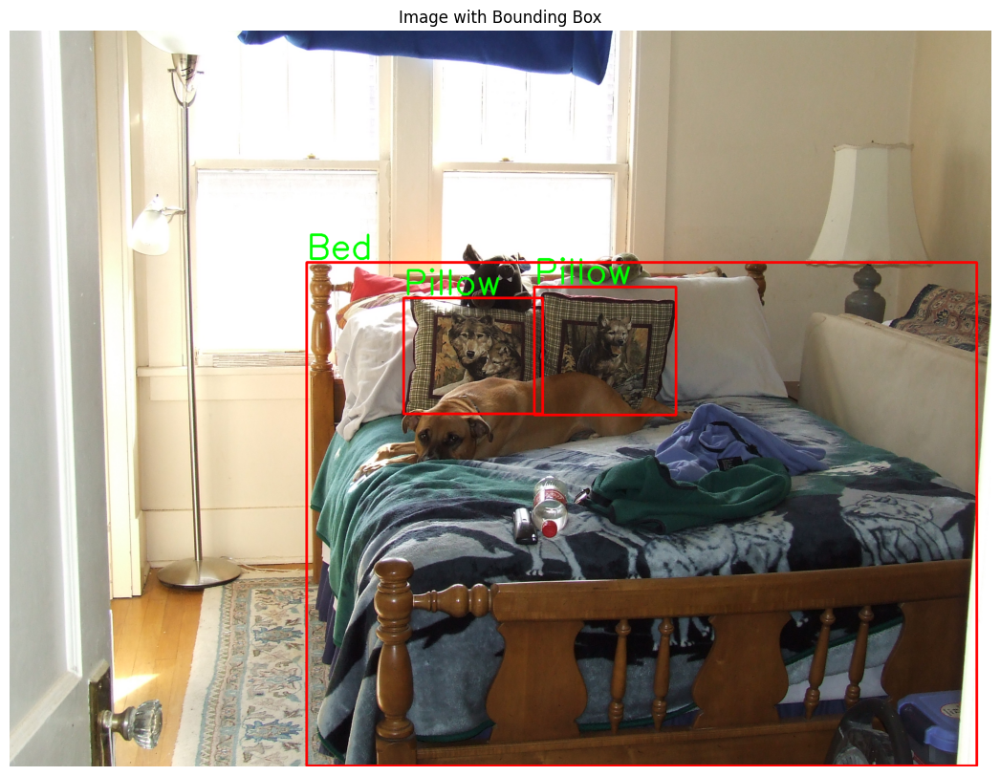

Image: (377, 567, 3)
Coordinates: (415, 226), (535, 375)
Coordinates: (0, 157), (565, 375)
Coordinates: (19, 296), (34, 313)
Coordinates: (71, 321), (98, 340)
Coordinates: (133, 269), (155, 286)
Coordinates: (143, 315), (191, 346)
Coordinates: (154, 365), (178, 375)
Coordinates: (178, 280), (225, 357)
Coordinates: (216, 361), (257, 375)
Coordinates: (251, 305), (324, 315)
Coordinates: (341, 273), (372, 330)
Coordinates: (384, 288), (445, 375)
Coordinates: (417, 225), (435, 259)
Coordinates: (427, 346), (526, 375)
Coordinates: (429, 219), (447, 259)
Coordinates: (451, 221), (463, 248)
Coordinates: (465, 211), (474, 242)
Coordinates: (490, 228), (508, 309)
Coordinates: (496, 219), (517, 296)
Coordinates: (508, 221), (531, 292)
Coordinates: (519, 211), (538, 273)
Coordinates: (537, 211), (547, 265)
Coordinates: (540, 205), (555, 255)
Coordinates: (0, 263), (43, 301)
Coordinates: (23, 286), (100, 336)
Coordinates: (55, 203), (86, 259)
Coordinates: (79, 317), (209, 375)
Coordinates: (125, 2

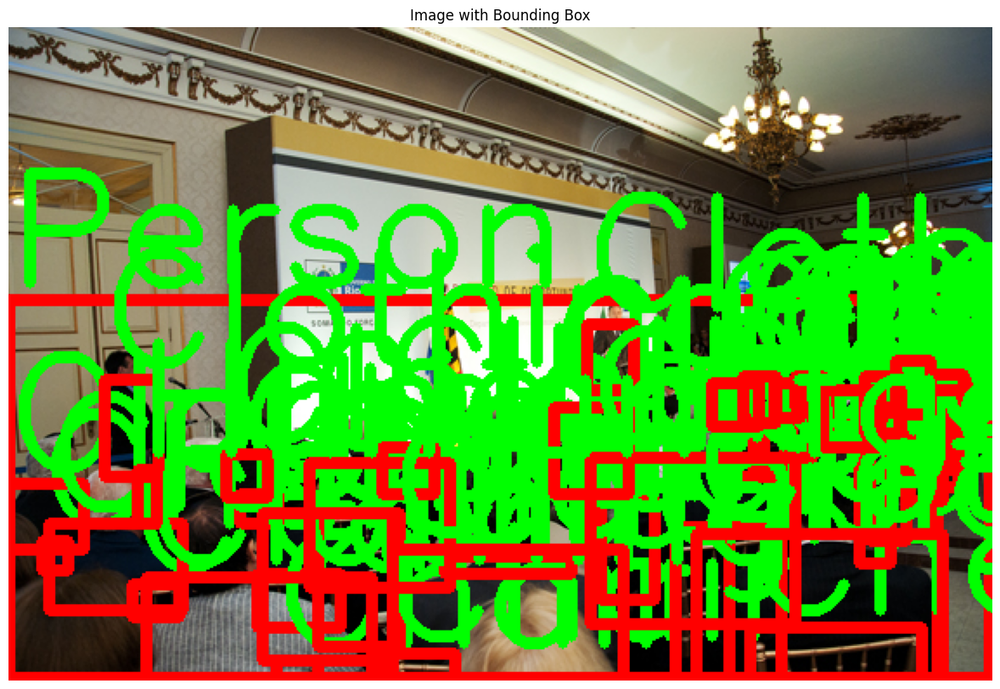

In [137]:
train_img_ids = train_df["FileName"].head().str.split(".").str[0].unique() # plotting the bounding box
for img_id in train_img_ids:
  plot_bbox(img_id)

In [138]:
val_df = pd.DataFrame(columns=['FileName', 'XMin', 'XMax', 'YMin', 'YMax', 'ClassName'])

test_df = pd.DataFrame(columns=['FileName', 'XMin', 'XMax', 'YMin', 'YMax', 'ClassName'])

# find boxes in each image and put them in a dataframe
test_imgs = os.listdir(test_path)
test_imgs = [name for name in test_imgs if not name.startswith('.')]

for i in range(len(test_imgs)):
    sys.stdout.write('Parse test_imgs ' + str(i) + '; Number of boxes: ' + str(len(test_df)) + '\r')
    sys.stdout.flush()
    img_name = test_imgs[i]
    img_id = img_name[0:16]
    tmp_df = annotations_bbox[annotations_bbox['ImageID']==img_id]
    for index, row in tmp_df.iterrows():
        labelName = row['LabelName']
        for i in range(len(label_names)):
            if labelName == label_names[i]:
                val_df = val_df.append({'FileName': img_name, 
                                            'XMin': row['XMin'], 
                                            'XMax': row['XMax'], 
                                            'YMin': row['YMin'], 
                                            'YMax': row['YMax'], 
                                            'ClassName': classes[i]}, 
                                           ignore_index=True)

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,


C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users\astit\AppData\Local\Temp\ipykernel_5288\2732706409.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  val_df = val_df.append({'FileName': img_name,
C:\Users

In [139]:
val_df.head()

,FileName,XMin,XMax,YMin,YMax,ClassName
0,00033bc5b18e08ad.jpg,0.222743,0.382181,0.805469,0.941406,Table
1,00033bc5b18e08ad.jpg,0.248535,0.403283,0.796875,0.929688,Table
2,00033bc5b18e08ad.jpg,0.304807,0.452521,0.786719,0.905469,Table
3,00033bc5b18e08ad.jpg,0.325909,0.467761,0.778125,0.896875,Table
4,00033bc5b18e08ad.jpg,0.336460,0.475967,0.771094,0.888281,Table


In [140]:
test_df.head()

,FileName,XMin,XMax,YMin,YMax,ClassName


In [141]:
train_df.to_csv('train.csv')
test_df.to_csv('test.csv')

In [142]:
train_df = pd.read_csv('train.csv')

# for training
with open("annotation.txt", "w+") as f:
  for idx, row in train_df.iterrows():
      img = cv2.imread('train/' + row['FileName'])
      height, width = img.shape[:2]
      x1 = int(row['XMin'] * width)
      x2 = int(row['XMax'] * width)
      y1 = int(row['YMin'] * height)
      y2 = int(row['YMax'] * height)
      
      train_file_path = './train'
      fileName = os.path.join(train_file_path, row['FileName'])
      className = row['ClassName']
      f.write(fileName + ',' + str(x1) + ',' + str(y1) + ',' + str(x2) + ',' + str(y2) + ',' + className + '\n')

In [ ]:
test_df= pd.read_csv('test.csv')

# for test
with open("test_annotation.txt", "w+") as f:
  for idx, row in test_df.iterrows():
      sys.stdout.write(str(idx) + '\r')
      sys.stdout.flush()
      img = cv2.imread('test/' + row['FileName'])
      height, width = img.shape[:2]
      x1 = int(row['XMin'] * width)
      x2 = int(row['XMax'] * width)
      y1 = int(row['YMin'] * height)
      y2 = int(row['YMax'] * height)
      
      test_file_path = 'D:/5-deep_learning_with_tensorflow/module 7 cnn/7-faster_r-cnn/Faster_r-cnn_demo_youtube/test'
      fileName = os.path.join(test_file_path, row['FileName'])
      className = row['ClassName']
      f.write(fileName + ',' + str(x1) + ',' + str(y1) + ',' + str(x2) + ',' + str(y2) + ',' + className + '\n')